## Import modules

In [205]:
import tensorflow as tf
import numpy as np
import os
import random
import shutil
from sklearn.manifold import TSNE
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from random import sample

In [206]:
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Num GPUs Available:  1


### function definitions

In [230]:
# functions to plot images with labels
# code inspired by https://www.tensorflow.org/tutorials/keras/classification

def plot_image(img, label_true, class_names, label_pred=[]):
    
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])
    plt.imshow(img)

    label_t = np.argmax(label_true)

    if len(label_pred) > 0:
        label_p = np.argmax(label_pred)
        if label_p == label_t:
            color = 'black'
        else:
            color = 'red'
        plt.xlabel("{} {:2.0f}% ({})".format(class_names[label_p],
                                             100*np.max(label_pred),
                                             class_names[label_t]),
                                             color=color)
    else:
        plt.xlabel("{}".format(class_names[label_t]))

def plot_images(n, images, labels_true, class_names, labels_pred=[], sample_images=True):
    if sample_images:
        ind = sample(range(len(images)), n)
    else:
        ind = range(n)
    imgs = [img for i,img in enumerate(images) if i in ind]
    lab_t = [lab for i,lab in enumerate(labels_true) if i in ind]
    if len(labels_pred) > 0:
        lab_p = [lab for i,lab in enumerate(labels_pred) if i in ind]
    else:
        lab_p = [[] for i in ind]

    num_cols = 7
    num_rows = n // 7
    num_images = num_rows*num_cols
    plt.figure(figsize=(num_cols*3, num_rows*3))
    for i in range(num_images):
        plt.subplot(num_rows, num_cols, i+1)
        plot_image(imgs[i], lab_t[i], class_names, lab_p[i])
    plt.subplots_adjust(bottom=0.1)
    plt.show()

In [231]:
# CAM function
# https://towardsdatascience.com/class-activation-mapping-using-transfer-learning-of-resnet50-e8ca7cfd657e
# modified to work in the context of frozen layers and the xception network
import scipy

def get_class_activation_map(model, base_model, img):
    
    # expand dimension to fit the image to a network accepted input size
    img = np.expand_dims(img, axis=0)

    # predict to get the winning class
    predictions = model.predict(img)
    label_index = np.argmax(predictions)

    # Get the 2048 input weights to the softmax of the winning class.
    class_weights = model.layers[-1].get_weights()[0]
    class_weights_winner = class_weights[:, label_index]
    
    # get the final conv layer
    final_conv_layer = base_model.get_layer("block14_sepconv2_act")
    
    # create a function to fetch the final conv layer output maps (should be shape (1, 10, 10, 2048)) 
    #get_output = tf.keras.backend.function([model.layers[0].input],[final_conv_layer.output, model.layers[-1].output])
    #[conv_outputs, predictions] = get_output([img])

    model_stub = tf.keras.models.Model(inputs=base_model.input, outputs=base_model.get_layer("block14_sepconv2_act").output)
    conv_outputs = model_stub.predict(img)
    predictions = model.predict(img)

    # squeeze conv map to shape image to size (10, 10, 2048)
    conv_outputs = np.squeeze(conv_outputs)

    # bilinear upsampling to resize each filtered image to size of original image 
    mat_for_mult = scipy.ndimage.zoom(conv_outputs, (29.9, 29.9, 1), order=1) # dim: 299 x 299 x 2048

    # get class activation map for object class that is predicted to be in the image
    final_output = np.dot(mat_for_mult.reshape((299*299, 2048)), class_weights_winner).reshape(299,299) # dim: 299 x 299
    
    # return class activation map
    return final_output

# function to plot the cams together with original image
def plot_images_cam(n, images, labels_true, class_names, model, base_model, labels_pred=[], sample_images=True):
    if sample_images:
        ind = sample(range(len(images)), n)
    else:
        ind = range(n)
    imgs = [img for i,img in enumerate(images) if i in ind]
    lab_t = [lab for i,lab in enumerate(labels_true) if i in ind]
    if len(labels_pred) > 0:
        lab_p = [lab for i,lab in enumerate(labels_pred) if i in ind]
    else:
        lab_p = [[] for i in ind]

    cams = [get_class_activation_map(model, base_model, img) for img in imgs]

    num_cols = 5
    num_rows = n // 5
    num_images = num_rows*num_cols
    plt.figure(figsize=(num_cols*4, num_rows*4))
    for i in range(num_images):
        plt.subplot(num_rows, num_cols, i+1)
        plot_image(imgs[i], lab_t[i], class_names, lab_p[i])
        plt.imshow(cams[i], alpha=0.5)
    plt.subplots_adjust(bottom=0.1)
    plt.show()

## Test set generation

In [3]:
f_ausschuss = os.listdir("labeled data/ausschuss")
f_cat = os.listdir("labeled data/cat")
f_nocat = os.listdir("labeled data/nocat")

In [22]:
""" os.rmdir('test_data')
os.mkdir('test_data')
os.mkdir('test_data/ausschuss')
os.mkdir('test_data/cat')
os.mkdir('test_data/nocat') """

In [23]:
f_ausschuss_test = random.sample(f_ausschuss, k=int(len(f_ausschuss)*0.2))
f_cat_test = random.sample(f_cat, k=int(len(f_cat)*0.2))
f_nocat_test = random.sample(f_nocat, k=int(len(f_nocat)*0.2))

In [25]:
""" for f in f_ausschuss_test:
    shutil.move('labeled data/ausschuss/'+f, 'test_data/ausschuss/'+f) """

In [26]:
""" for f in f_cat_test:
    shutil.move('labeled data/cat/'+f, 'test_data/cat/'+f) """

In [27]:
""" for f in f_nocat_test:
    shutil.move('labeled data/nocat/'+f, 'test_data/nocat/'+f) """

## Image preprocessing

In [3]:
def norm(image,label):
    image = tf.cast(image/255. ,tf.float32)
    return image,label

In [4]:
data_train = tf.keras.preprocessing.image_dataset_from_directory(
    "labeled data/",
    label_mode='categorical',
    color_mode="rgb",
    batch_size=32,
    image_size=(299, 299),
    validation_split=0.2,
    subset='training',
    seed=1234
)
data_train = data_train.map(norm)

Found 12675 files belonging to 3 classes.
Using 10140 files for training.


In [5]:
data_val = tf.keras.preprocessing.image_dataset_from_directory(
    "labeled data/",
    label_mode='categorical',
    color_mode="rgb",
    image_size=(299, 299),
    validation_split=0.2,
    subset='validation',
    seed=1234
)
data_val = data_val.map(norm)

Found 12675 files belonging to 3 classes.
Using 2535 files for validation.


In [6]:
l1 = list(data_val.as_numpy_iterator())
val_labels = [item for sublist in [x[1] for x in l1] for item in sublist]
val_images = [item for sublist in [x[0] for x in l1] for item in sublist]

In [18]:
class_names = ['ausschuss', 'cat', 'nocat']

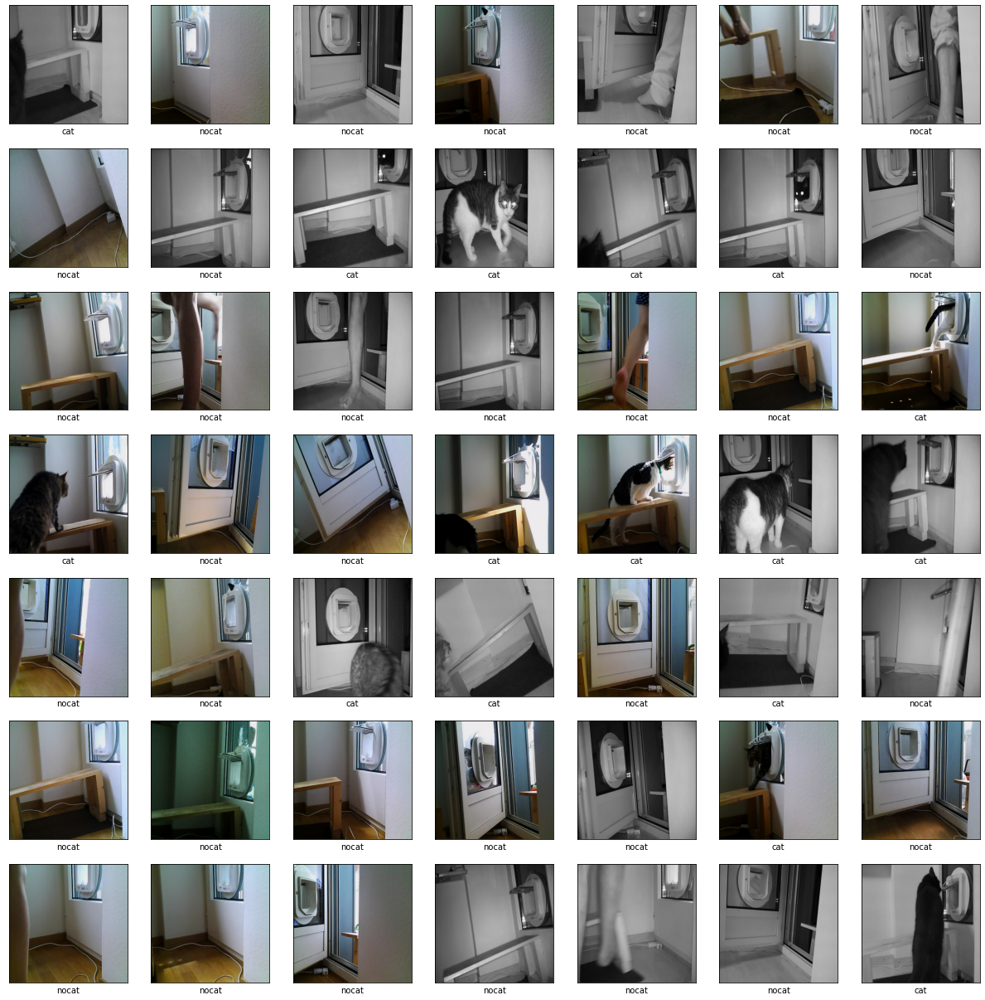

In [232]:
plot_images(50, val_images, val_labels, class_names)

## Feature extraction from pre-trained Xception net

In [127]:
model = tf.keras.applications.xception.Xception(weights='imagenet')
model.summary()

Model: "xception"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 299, 299, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 149, 149, 32) 864         input_2[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 149, 149, 32) 128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 149, 149, 32) 0           block1_conv1_bn[0][0]            
___________________________________________________________________________________________

In [128]:
model_stub = tf.keras.models.Model(inputs=model.input, outputs=model.get_layer('avg_pool').output)
model_stub.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 299, 299, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 149, 149, 32) 864         input_2[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 149, 149, 32) 128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 149, 149, 32) 0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

In [129]:
val_images[0].shape

(299, 299, 3)

In [131]:
features = model_stub.predict(np.array(val_images))

In [132]:
features.shape

(2535, 2048)

In [133]:
features_embedded = TSNE(n_components=2, init='pca').fit_transform(features)

<AxesSubplot:xlabel='tsne1', ylabel='tsne2'>

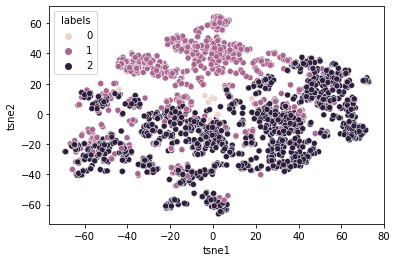

In [134]:
df = pd.DataFrame(features_embedded)
df.columns = ['tsne1', 'tsne2']
df['labels'] = np.array([np.argmax(x) for x in val_labels])
sns.scatterplot(data=df, x='tsne1', y='tsne2', hue='labels')

## retraining classification layer

In [135]:
from tensorflow import keras

# take base model and freeze
base_model = tf.keras.applications.xception.Xception(weights='imagenet', 
    include_top=False,
    input_shape=(299,299,3)
)
base_model.trainable = False

# set input shape
inputs = keras.Input(shape=(299, 299, 3))
# add inputs to base model
x = base_model(inputs, training=False)
# add pooling and last dense layer
x = keras.layers.GlobalAveragePooling2D()(x)
x = keras.layers.Dense(2048, activation='relu')(x)
# add classification layer
outputs = keras.layers.Dense(3, activation='softmax')(x)
# stick model together
model = keras.Model(inputs, outputs)

# compile
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

In [136]:
model.summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 299, 299, 3)]     0         
_________________________________________________________________
xception (Functional)        (None, 10, 10, 2048)      20861480  
_________________________________________________________________
global_average_pooling2d (Gl (None, 2048)              0         
_________________________________________________________________
dense (Dense)                (None, 2048)              4196352   
_________________________________________________________________
dense_1 (Dense)              (None, 3)                 6147      
Total params: 25,063,979
Trainable params: 4,202,499
Non-trainable params: 20,861,480
_________________________________________________________________


In [137]:
# train the model
history=model.fit(data_train,
                  epochs=10,
                  verbose=1,
                  validation_data=data_val
                 )
model.save('model_new_classes')

Epoch 1/10
317/317 [==============================] - 316s 972ms/step - loss: 0.2889 - accuracy: 0.9074 - val_loss: 0.0839 - val_accuracy: 0.9767
Epoch 2/10
317/317 [==============================] - 197s 615ms/step - loss: 0.0912 - accuracy: 0.9743 - val_loss: 0.0648 - val_accuracy: 0.9811
Epoch 3/10
317/317 [==============================] - 203s 636ms/step - loss: 0.0666 - accuracy: 0.9799 - val_loss: 0.0657 - val_accuracy: 0.9826
Epoch 4/10
317/317 [==============================] - 208s 654ms/step - loss: 0.0622 - accuracy: 0.9806 - val_loss: 0.0636 - val_accuracy: 0.9826
Epoch 5/10
317/317 [==============================] - 223s 698ms/step - loss: 0.0472 - accuracy: 0.9861 - val_loss: 0.0612 - val_accuracy: 0.9842
Epoch 6/10
317/317 [==============================] - 215s 674ms/step - loss: 0.0489 - accuracy: 0.9852 - val_loss: 0.0621 - val_accuracy: 0.9834
Epoch 7/10
317/317 [==============================] - 217s 681ms/step - loss: 0.0431 - accuracy: 0.9859 - val_loss: 0.0587 -

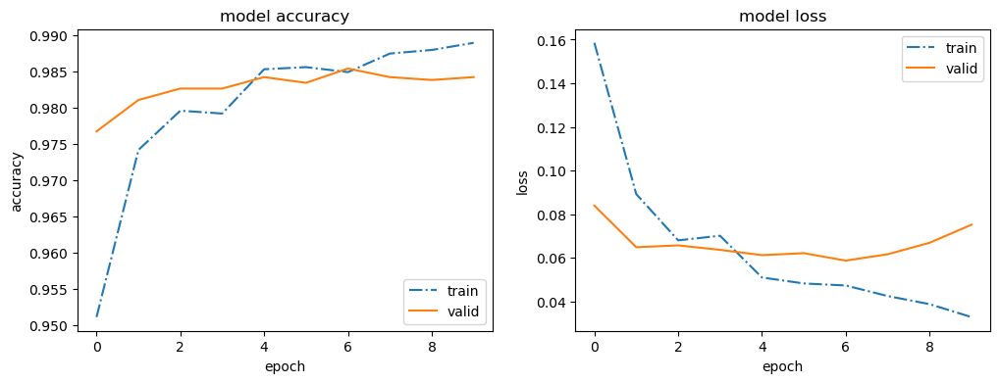

In [138]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.style.use('default')
# plot the development of the accuracy and loss during training
plt.figure(figsize=(12,4))
plt.subplot(1,2,(1))
plt.plot(history.history['accuracy'],linestyle='-.')
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'valid'], loc='lower right')
plt.subplot(1,2,(2))
plt.plot(history.history['loss'],linestyle='-.')
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'valid'], loc='upper right')
plt.show()

<AxesSubplot:xlabel='tsne1', ylabel='tsne2'>

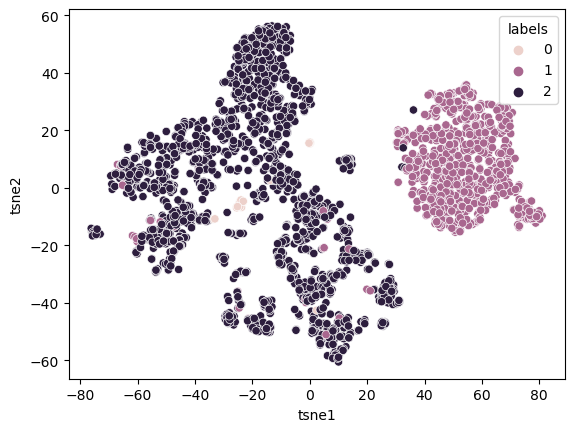

In [139]:
model_stub = tf.keras.models.Model(inputs=model.input, outputs=model.get_layer('dense').output)
features = model_stub.predict(np.array(val_images))
features_embedded = TSNE(n_components=2, init='pca').fit_transform(features)
df = pd.DataFrame(features_embedded)
df.columns = ['tsne1', 'tsne2']
df['labels'] = np.array([np.argmax(x) for x in val_labels])
sns.scatterplot(data=df, x='tsne1', y='tsne2', hue='labels')

### Visualize predictions
Code for functions from https://www.tensorflow.org/tutorials/keras/classification

In [43]:
model = tf.keras.models.load_model("model_new_classes")

In [221]:
predictions = model.predict(np.array(val_images))

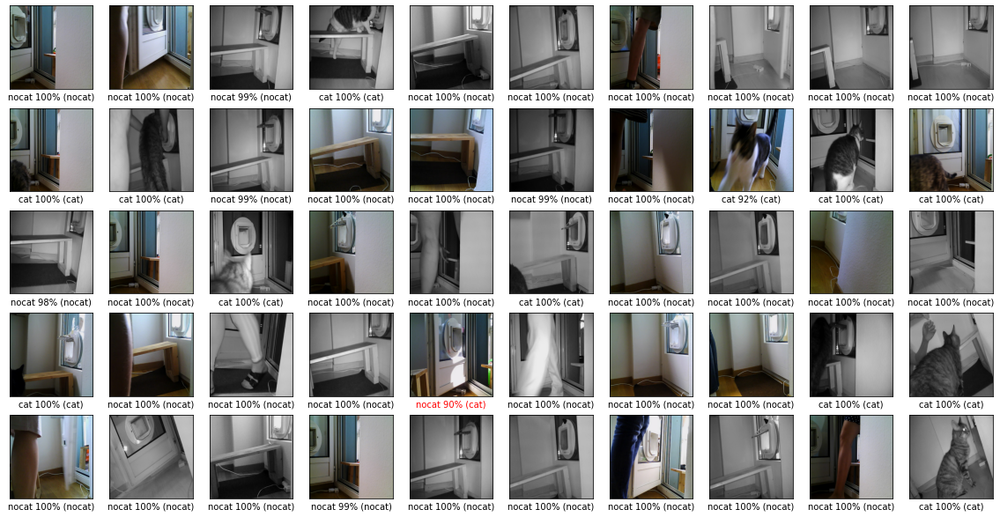

In [48]:
plot_images(50, val_images, val_labels, class_names, labels_pred=predictions)

## Dropout layer

In [150]:
from tensorflow import keras

# take base model and freeze
base_model = tf.keras.applications.xception.Xception(weights='imagenet', 
    include_top=False,
    input_shape=(299,299,3)
)
base_model.trainable = False

# set input shape
inputs = keras.Input(shape=(299, 299, 3))
# add inputs to base model
x = base_model(inputs, training=False)
# add pooling and last dense layer
x = keras.layers.GlobalAveragePooling2D()(x)
x = keras.layers.Dense(2048, activation='relu')(x)
x = keras.layers.Dropout(0.5)(x)
# add classification layer
outputs = keras.layers.Dense(3, activation='softmax')(x)
# stick model together
model = keras.Model(inputs, outputs)

# compile
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

In [8]:
# train the model
history=model.fit(data_train,
                  epochs=10,
                  verbose=1,
                  validation_data=data_val
                 )
model.save('model_new_classes_dropout')

Epoch 1/10
317/317 [==============================] - 260s 780ms/step - loss: 0.2846 - accuracy: 0.9108 - val_loss: 0.0980 - val_accuracy: 0.9740
Epoch 2/10
317/317 [==============================] - 180s 564ms/step - loss: 0.1092 - accuracy: 0.9690 - val_loss: 0.0777 - val_accuracy: 0.9779
Epoch 3/10
317/317 [==============================] - 191s 602ms/step - loss: 0.0880 - accuracy: 0.9735 - val_loss: 0.0654 - val_accuracy: 0.9795
Epoch 4/10
317/317 [==============================] - 194s 610ms/step - loss: 0.0784 - accuracy: 0.9768 - val_loss: 0.0684 - val_accuracy: 0.9803
Epoch 5/10
317/317 [==============================] - 193s 606ms/step - loss: 0.0696 - accuracy: 0.9790 - val_loss: 0.0709 - val_accuracy: 0.9803
Epoch 6/10
317/317 [==============================] - 192s 605ms/step - loss: 0.0742 - accuracy: 0.9802 - val_loss: 0.0641 - val_accuracy: 0.9822
Epoch 7/10
317/317 [==============================] - 195s 613ms/step - loss: 0.0665 - accuracy: 0.9801 - val_loss: 0.0598 -

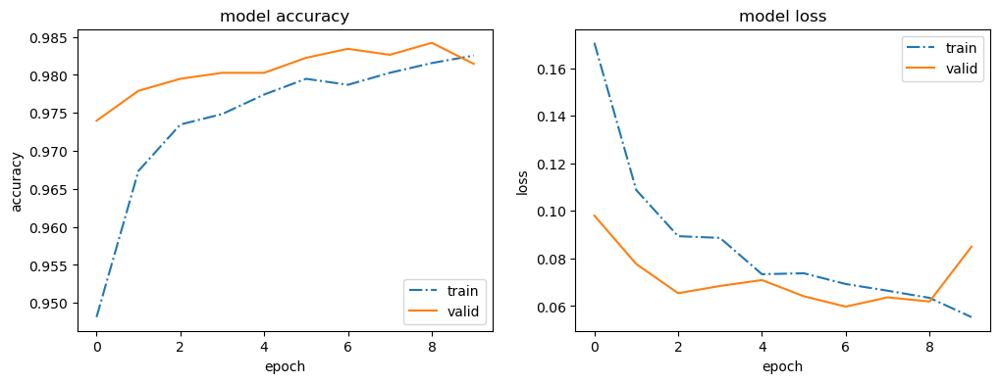

In [9]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.style.use('default')
# plot the development of the accuracy and loss during training
plt.figure(figsize=(12,4))
plt.subplot(1,2,(1))
plt.plot(history.history['accuracy'],linestyle='-.')
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'valid'], loc='lower right')
plt.subplot(1,2,(2))
plt.plot(history.history['loss'],linestyle='-.')
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'valid'], loc='upper right')
plt.show()

### Visualize predictions and groups

In [222]:
model = tf.keras.models.load_model("model_new_classes_dropout")
predictions = model.predict(np.array(val_images))

<AxesSubplot:xlabel='tsne1', ylabel='tsne2'>

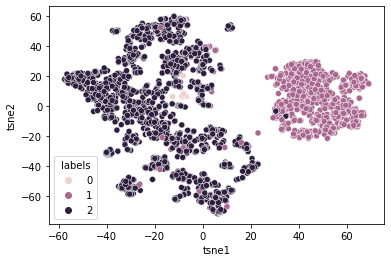

In [50]:
model_stub = tf.keras.models.Model(inputs=model.input, outputs=model.get_layer('dense').output)
features = model_stub.predict(np.array(val_images))
features_embedded = TSNE(n_components=2, init='pca').fit_transform(features)
df = pd.DataFrame(features_embedded)
df.columns = ['tsne1', 'tsne2']
df['labels'] = np.array([np.argmax(x) for x in val_labels])
sns.scatterplot(data=df, x='tsne1', y='tsne2', hue='labels')

<AxesSubplot:xlabel='tsne1', ylabel='tsne2'>

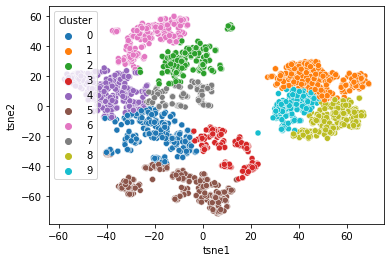

In [51]:
from sklearn.mixture import GaussianMixture
cluster = GaussianMixture(n_components=10,
                          covariance_type='full', 
                          max_iter=20, 
                          random_state=0)
cluster.fit(features_embedded)
clus = cluster.fit_predict(features_embedded)
df['cluster'] =  pd.Series(clus, dtype="category")
sns.scatterplot(data=df, x='tsne1', y='tsne2', hue='cluster')

In [ ]:
base_model = tf.keras.applications.xception.Xception(weights='imagenet', 
    include_top=False,
    input_shape=(299,299,3)
)

#### misclassified images

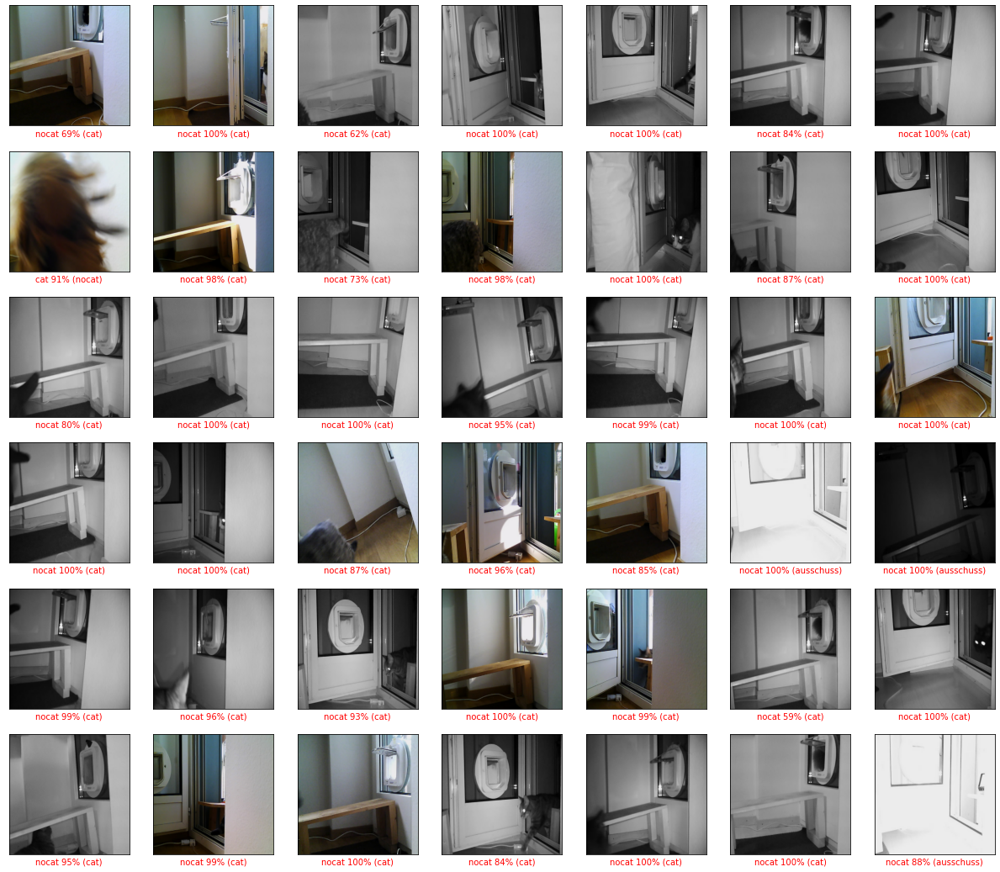

In [233]:
ind = [i for i,x in enumerate(np.array([np.argmax(x) for x in val_labels]) != np.array([np.argmax(x) for x in predictions])) if x]
plot_images(len(ind), [x for i,x in enumerate(val_images) if i in ind], [x for i,x in enumerate(val_labels) if i in ind], class_names, labels_pred=predictions[ind])

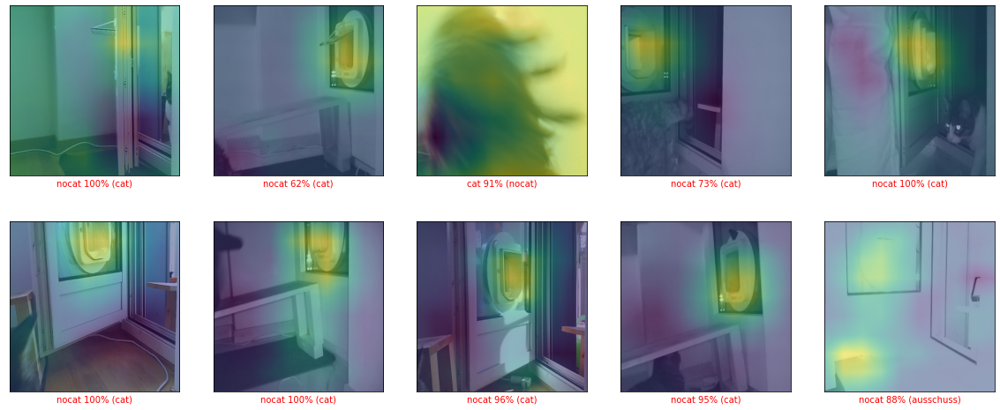

In [234]:
plot_images_cam(10, [x for i,x in enumerate(val_images) if i in ind], [x for i,x in enumerate(val_labels) if i in ind], class_names, model, base_model, predictions[ind], sample_images=True)

#### cat subgroups

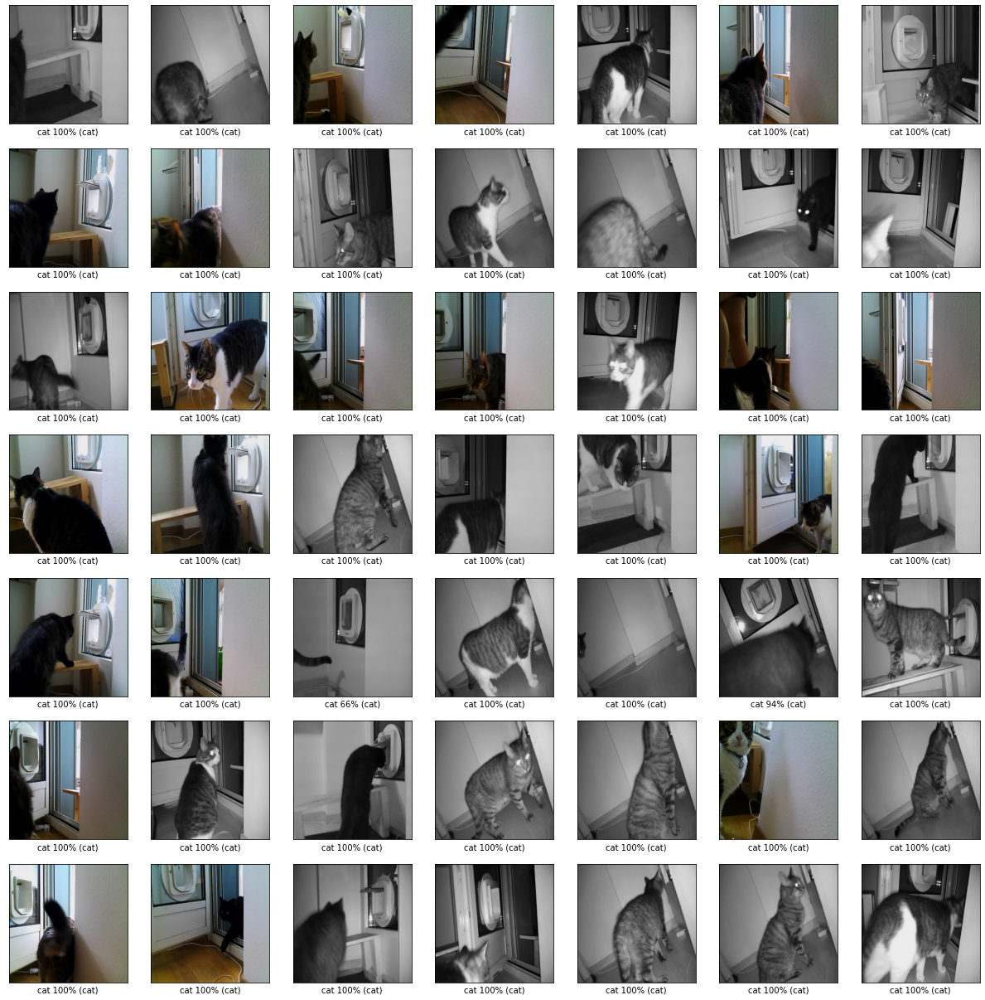

In [242]:
ind = np.where(clus == 1)[0]
plot_images(50, [x for i,x in enumerate(val_images) if i in ind], [x for i,x in enumerate(val_labels) if i in ind], class_names, labels_pred=predictions[ind])

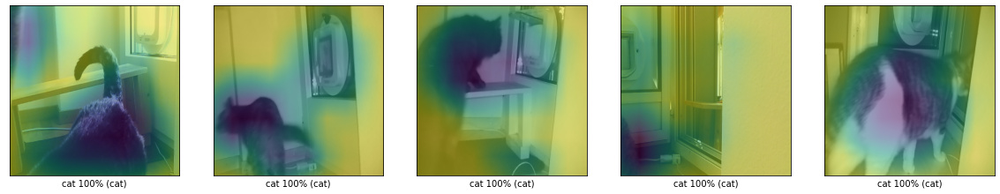

In [243]:
plot_images_cam(5, [x for i,x in enumerate(val_images) if i in ind], [x for i,x in enumerate(val_labels) if i in ind], class_names, model, base_model, predictions[ind], sample_images=True)

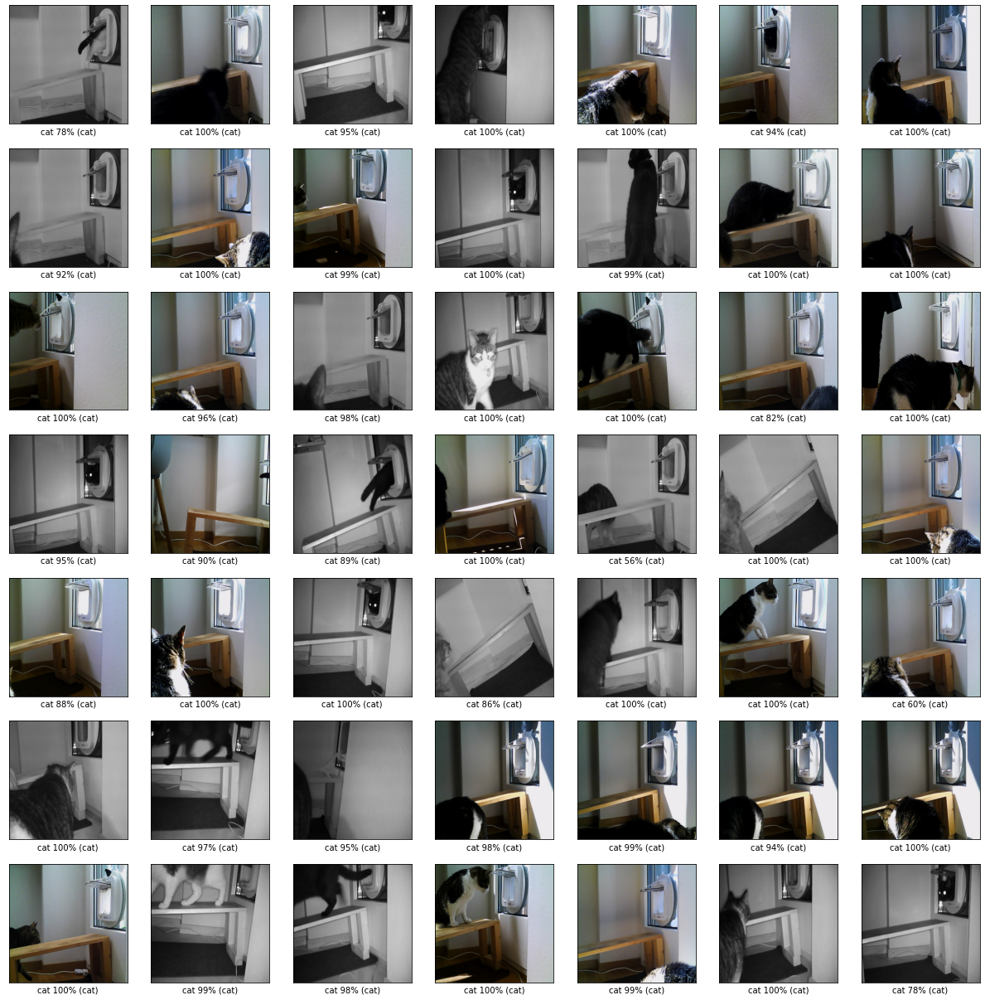

In [244]:
ind = np.where(clus == 9)[0]
plot_images(50, [x for i,x in enumerate(val_images) if i in ind], [x for i,x in enumerate(val_labels) if i in ind], class_names, labels_pred=predictions[ind])

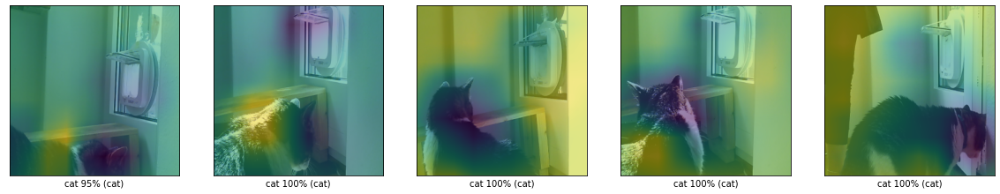

In [245]:
plot_images_cam(5, [x for i,x in enumerate(val_images) if i in ind], [x for i,x in enumerate(val_labels) if i in ind], class_names, model, base_model, predictions[ind], sample_images=True)

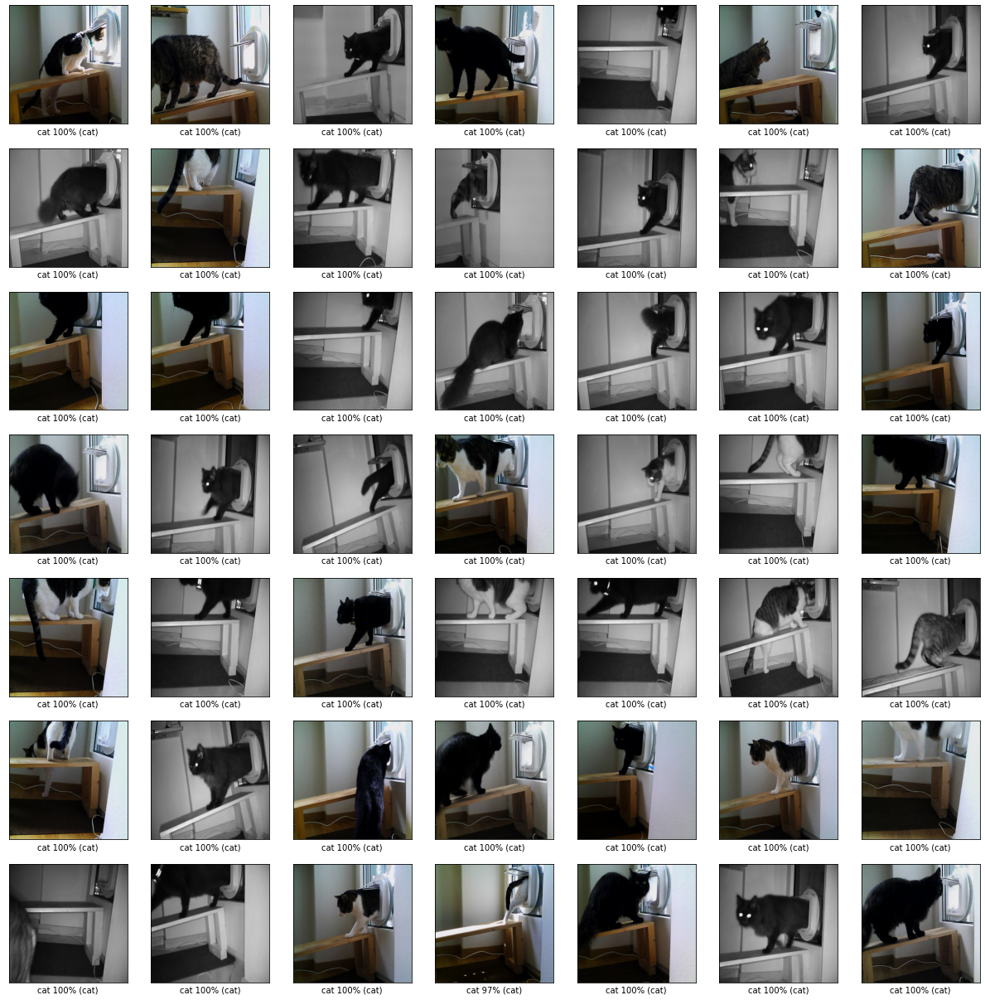

In [255]:
ind = np.where(clus == 8)[0]
plot_images(50, [x for i,x in enumerate(val_images) if i in ind], [x for i,x in enumerate(val_labels) if i in ind], class_names, labels_pred=predictions[ind])

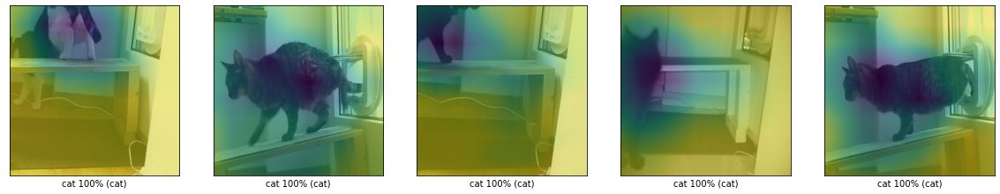

In [251]:
plot_images_cam(5, [x for i,x in enumerate(val_images) if i in ind], [x for i,x in enumerate(val_labels) if i in ind], class_names, model, base_model, predictions[ind], sample_images=True)

#### nocat subgroups

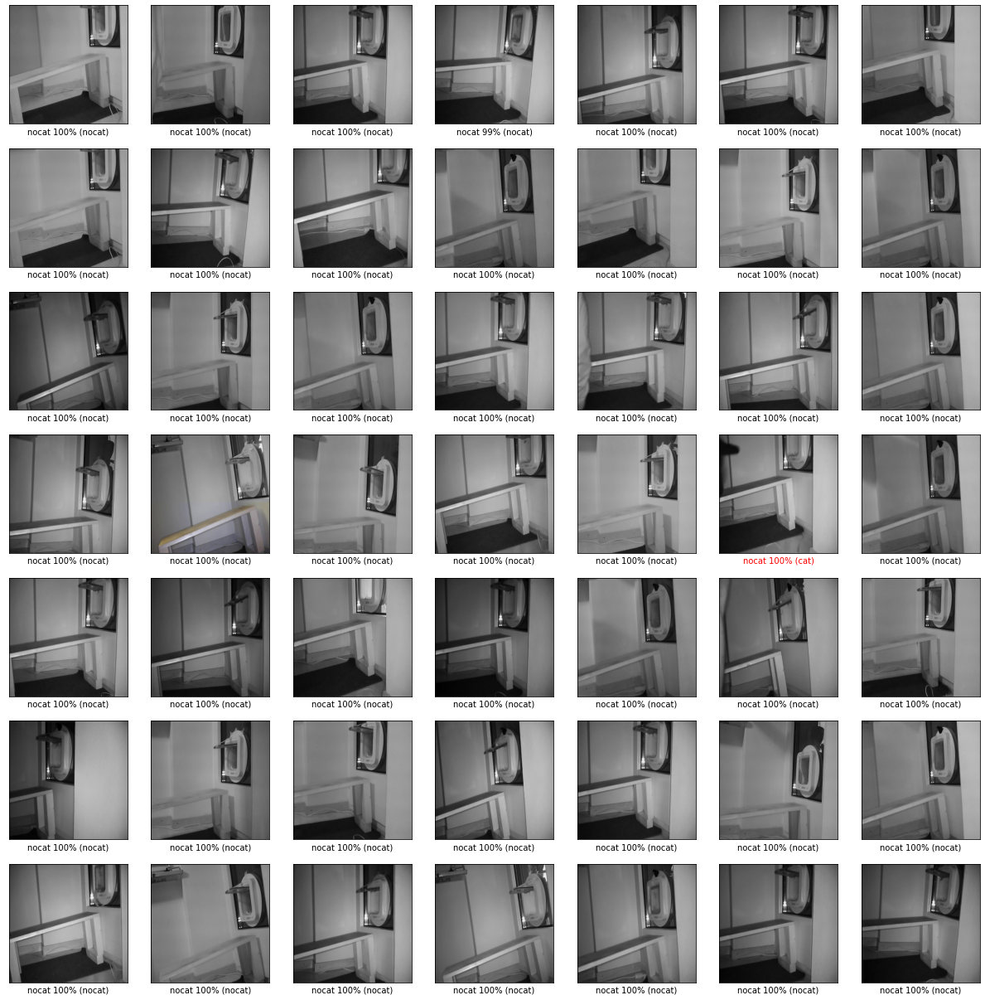

In [246]:
ind = np.where(clus == 5)[0]
plot_images(50, [x for i,x in enumerate(val_images) if i in ind], [x for i,x in enumerate(val_labels) if i in ind], class_names, labels_pred=predictions[ind])

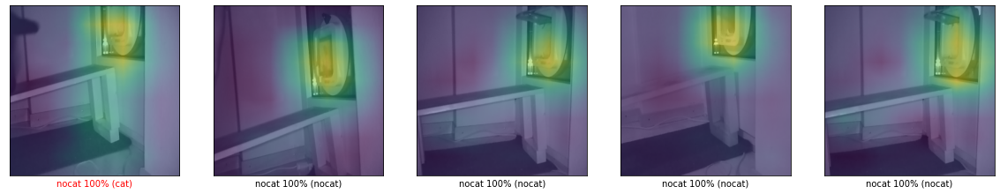

In [247]:
plot_images_cam(5, [x for i,x in enumerate(val_images) if i in ind], [x for i,x in enumerate(val_labels) if i in ind], class_names, model, base_model, predictions[ind], sample_images=True)

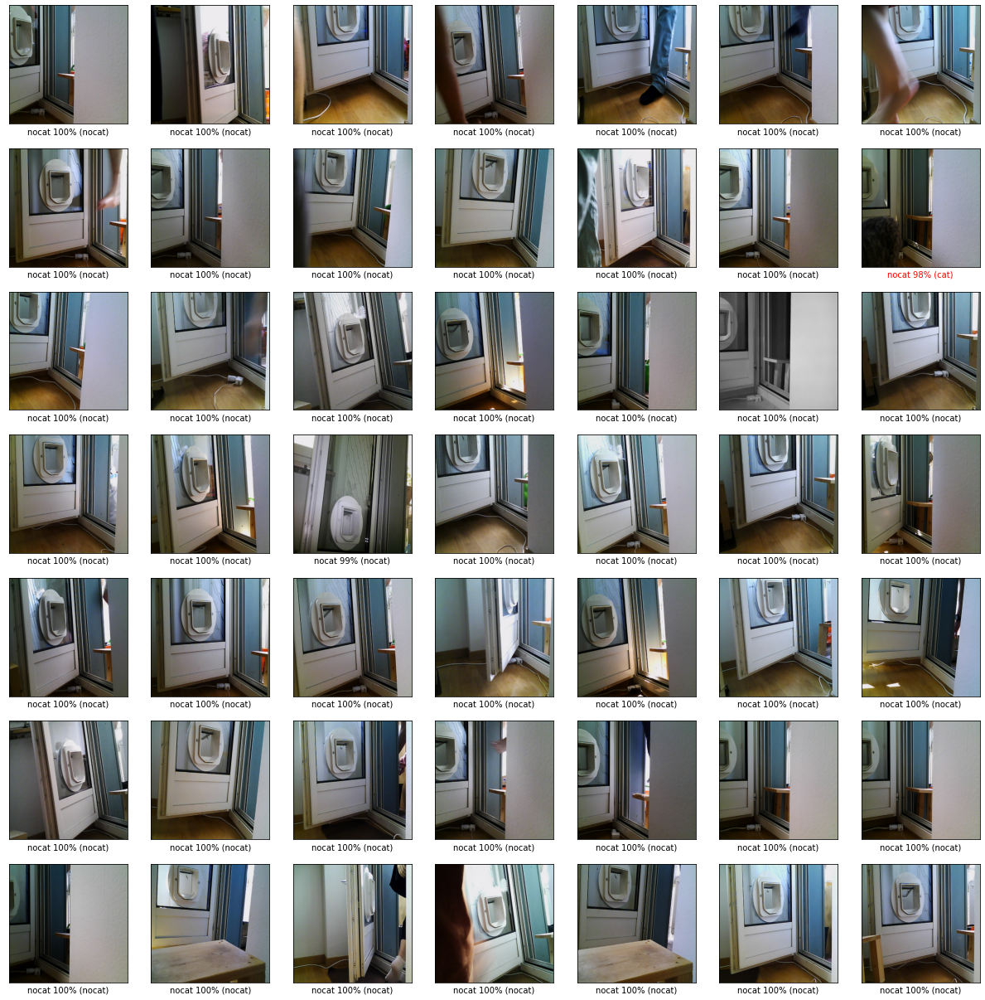

In [248]:
ind = np.where(clus == 6)[0]
plot_images(50, [x for i,x in enumerate(val_images) if i in ind], [x for i,x in enumerate(val_labels) if i in ind], class_names, labels_pred=predictions[ind])

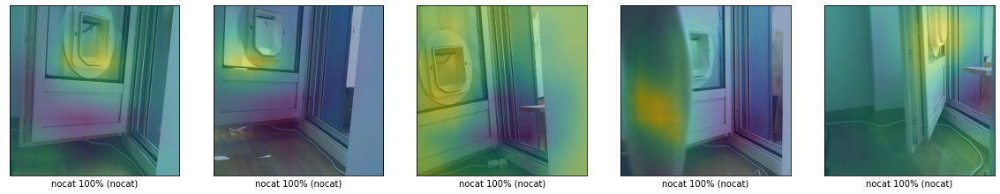

In [249]:
plot_images_cam(5, [x for i,x in enumerate(val_images) if i in ind], [x for i,x in enumerate(val_labels) if i in ind], class_names, model, base_model, predictions[ind], sample_images=True)